In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
import os

In [2]:
im = cv2.imread('red_laser.jpg')
im_rgb = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
im_array = np.array(im_rgb, dtype=np.uint8)
im_array

array([[[142, 156, 141],
        [141, 155, 140],
        [140, 154, 139],
        ...,
        [180, 206, 221],
        [181, 207, 222],
        [181, 207, 222]],

       [[134, 146, 132],
        [137, 149, 135],
        [138, 150, 136],
        ...,
        [181, 207, 222],
        [181, 207, 222],
        [179, 205, 220]],

       [[151, 163, 149],
        [139, 151, 137],
        [135, 147, 133],
        ...,
        [183, 209, 224],
        [182, 208, 223],
        [180, 206, 221]],

       ...,

       [[221, 211, 209],
        [224, 214, 212],
        [229, 219, 217],
        ...,
        [104, 155,  54],
        [100, 151,  48],
        [105, 156,  53]],

       [[221, 211, 210],
        [227, 217, 216],
        [231, 221, 219],
        ...,
        [102, 157,  53],
        [ 96, 152,  45],
        [ 96, 152,  45]],

       [[217, 207, 206],
        [224, 214, 213],
        [228, 218, 217],
        ...,
        [100, 155,  51],
        [ 97, 153,  46],
        [ 95, 151,  44]]

In [ ]:
frame_keypoints = model.inference(im_array)

WARNING ⚠️ NMS time limit 0.550s exceeded


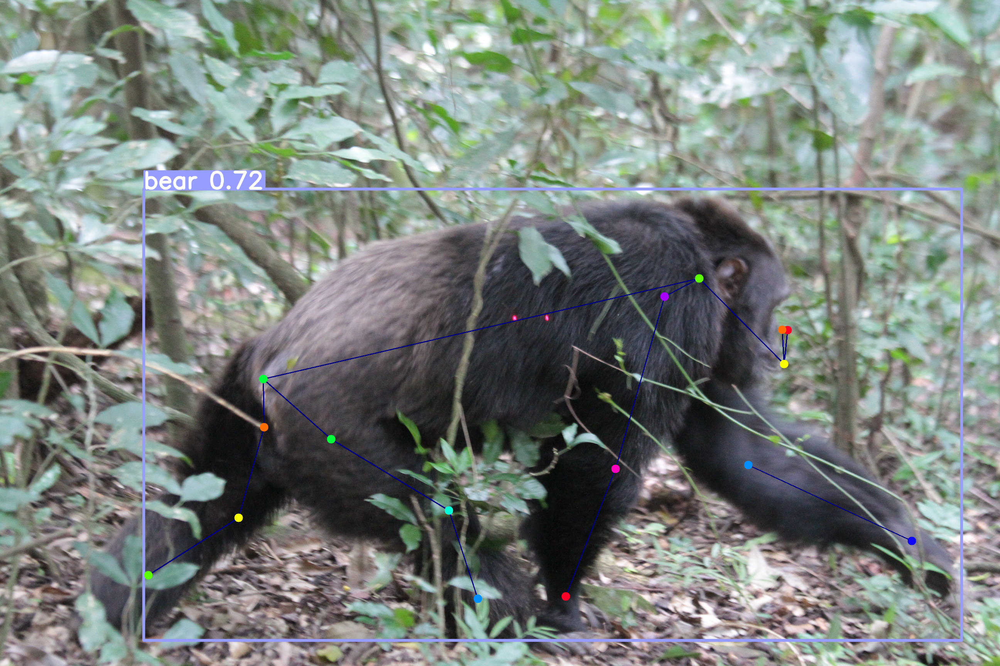

In [ ]:
img = model.draw(show_yolo=True)
cv2_imshow(img[..., ::-1])

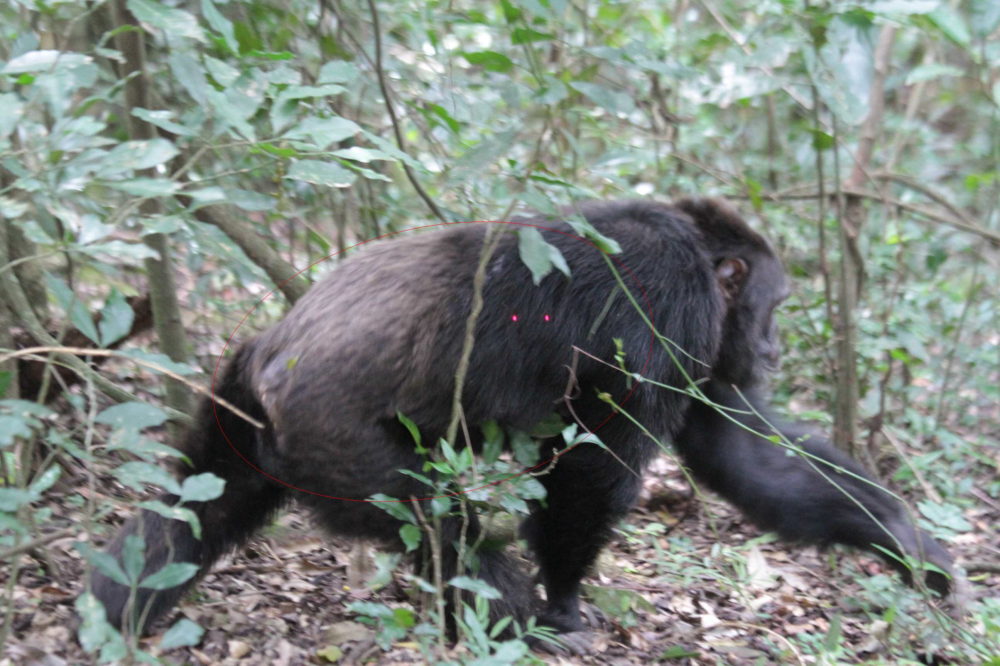

In [ ]:
shoulder = frame_keypoints[0][3]
shoulder = [shoulder[1], shoulder[0]]

rump = frame_keypoints[0][4]
rump = [rump[1], rump[0]]

center = ((shoulder[0] + rump[0]) / 2, (shoulder[1] + rump[1]) / 2)
center = (int(center[0] - (center[0] / 10)), int(center[1] + (center[1] / 10))) # Slightly adjust center

major_axis_length = np.sqrt(((shoulder[0] - rump[0])**2) + ((shoulder[1] - rump[1])**2))
half_major_axis = int(major_axis_length / 2)

minor_axis_length = int(0.6 * major_axis_length)  # Assume a minor axis 3/5 the length of the major axis (adjust as needed)
half_minor_axis = int(minor_axis_length / 2)

angle = np.rad2deg(np.arctan2(rump[1] - shoulder[1], rump[0] - shoulder[0]))  # Calculate angle in degrees
image = cv2.ellipse(im, center, (half_major_axis, half_minor_axis), angle, 0, 360, (0,0,255))


# Displaying the image
cv2_imshow(image)

In [ ]:
image = cv2.ellipse(im, center, (half_major_axis, half_minor_axis), angle, 0, 360, (0,0,255))

[[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]


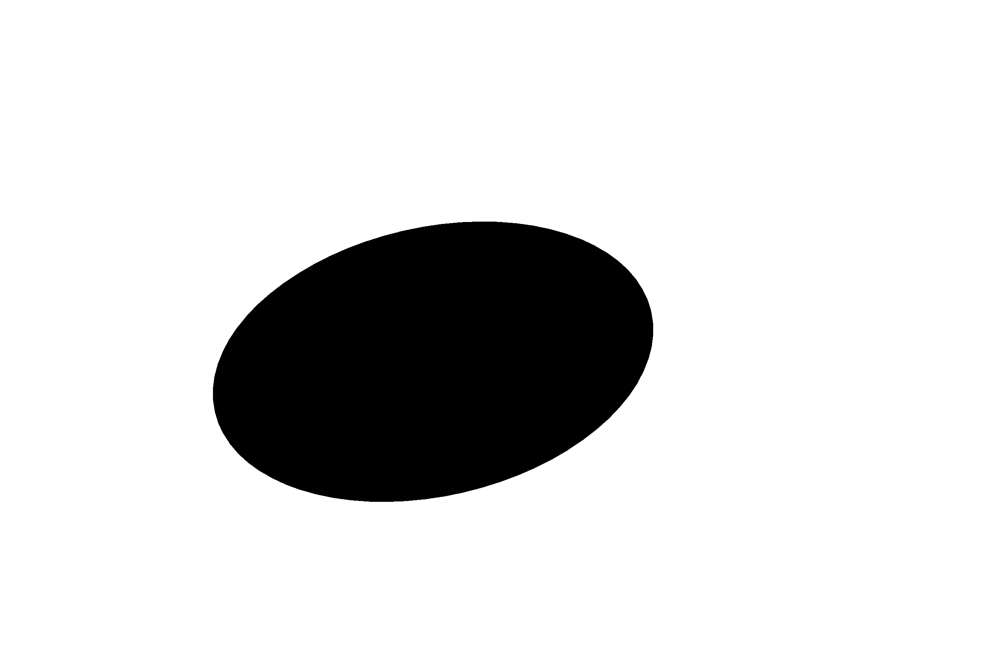

In [ ]:
width, height = im.shape[1], im.shape[0]
blank_image = np.ones((height, width, 3), np.uint8) * 255

# COPIED FROM EARLIER CELL
# ------------------------------------------------------------------------------------------------------------------------
shoulder = frame_keypoints[0][3]
shoulder = [shoulder[1], shoulder[0]]

rump = frame_keypoints[0][4]
rump = [rump[1], rump[0]]

center = ((shoulder[0] + rump[0]) / 2, (shoulder[1] + rump[1]) / 2)
center = (int(center[0] - (center[0] / 10)), int(center[1] + (center[1] / 10))) # Slightly adjust center

major_axis_length = np.sqrt(((shoulder[0] - rump[0])**2) + ((shoulder[1] - rump[1])**2))
half_major_axis = int(major_axis_length / 2)

minor_axis_length = int(0.6 * major_axis_length)  # Assume a minor axis 3/5 the length of the major axis (adjust as needed)
half_minor_axis = int(minor_axis_length / 2)

angle = np.rad2deg(np.arctan2(rump[1] - shoulder[1], rump[0] - shoulder[0]))  # Calculate angle in degrees
# ------------------------------------------------------------------------------------------------------------------------

color = (0,0,0)
thickness = -1

grey_ellipse = cv2.ellipse(blank_image, center, (half_major_axis, half_minor_axis), angle, 0, 360, color, thickness)
grey_ellipse = cv2.cvtColor(grey_ellipse, cv2.COLOR_BGR2GRAY)
print(grey_ellipse)

# Display the original and greyscale images
cv2_imshow(grey_ellipse)

In [ ]:
import torch
import torchvision
print("PyTorch version:", torch.__version__)
print("Torchvision version:", torchvision.__version__)
print("CUDA is available:", torch.cuda.is_available())
import sys
!{sys.executable} -m pip install opencv-python matplotlib
!{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

!mkdir images
!wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/truck.jpg
!wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/groceries.jpg

!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

PyTorch version: 2.1.0+cu121
Torchvision version: 0.16.0+cu121
CUDA is available: True
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-w3osw7fj
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-w3osw7fj
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36587 sha256=d0e200ef8a755443e800c9bec17565131dfbca8204f7e2000dcbd4688c70cc90
  Stored in directory: /tmp/pip-ephem-wheel-cache-2h5mp7zu/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
--2024-02-19 18:50:04--  https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/truck.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.c

In [ ]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

In [ ]:
segment_im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)

In [ ]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)

In [ ]:
predictor.set_image(segment_im)
input_point = np.array([[1870, 1165]])
input_label = np.array([1])

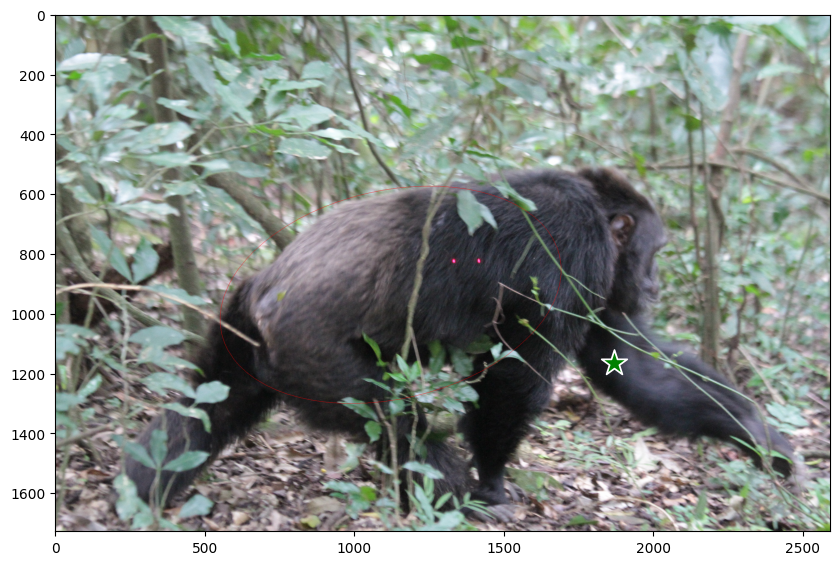

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(segment_im)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()

In [ ]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

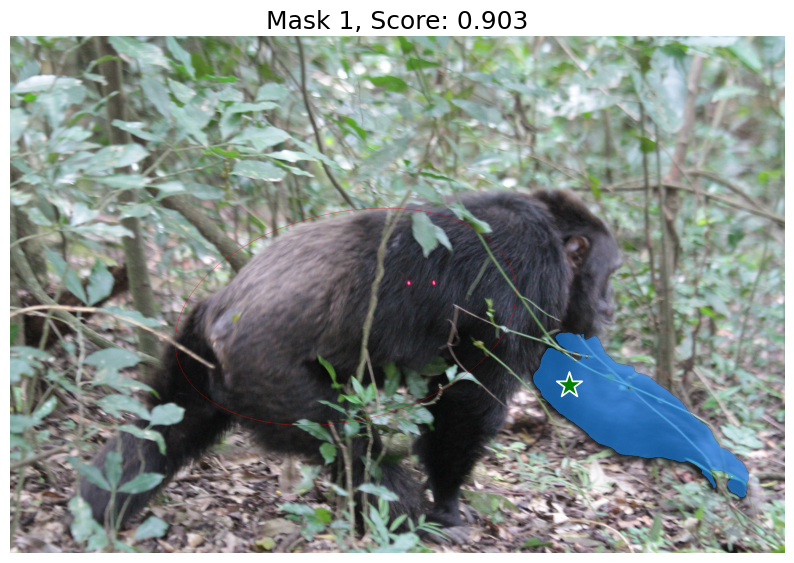

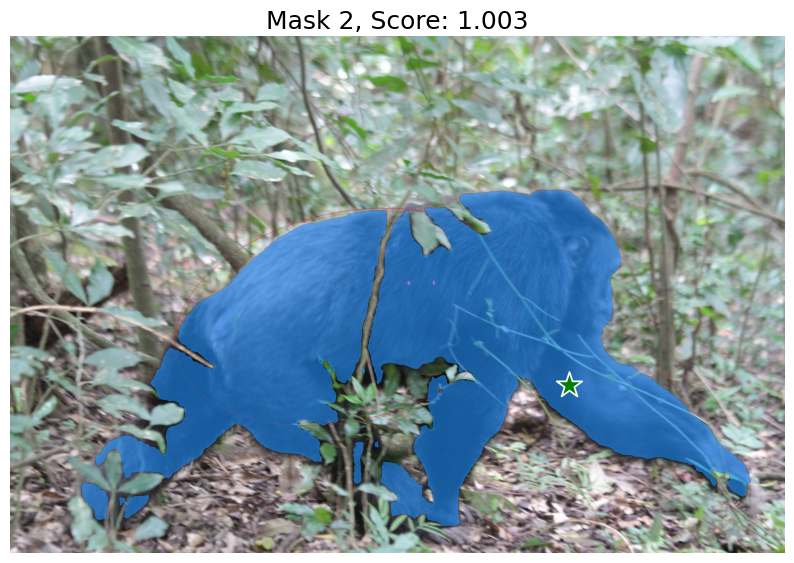

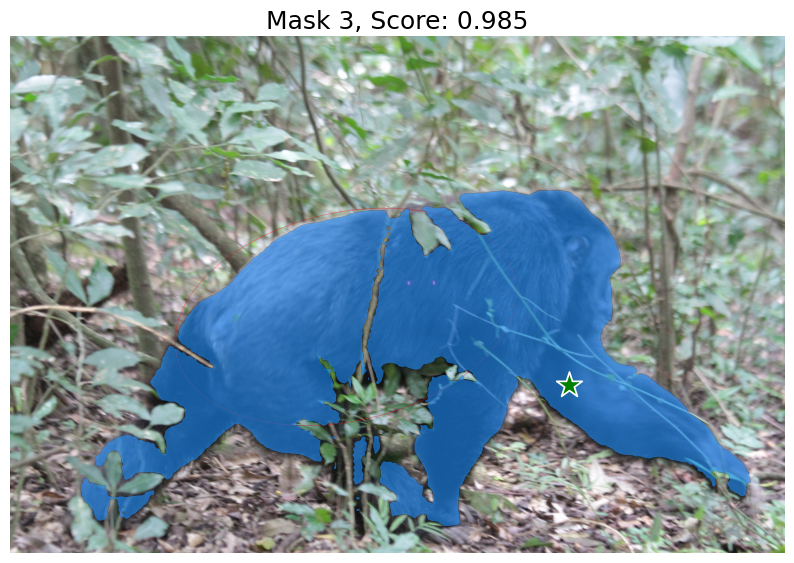

In [ ]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(segment_im)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()

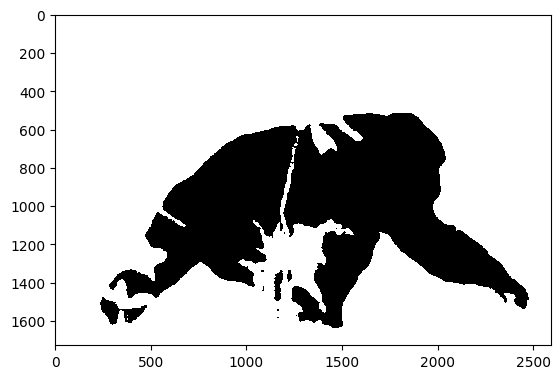

In [ ]:
segmentation_mask = masks[2]
segmentation_mask_reformatted = [[255 if not value else 0 for value in row] for row in segmentation_mask]

plt.imshow(segmentation_mask_reformatted, cmap='gray', interpolation='nearest')
plt.show()

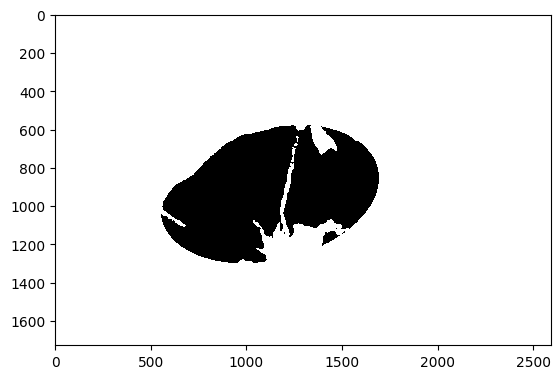

In [ ]:
ROWS, COLS = len(grey_ellipse), len(grey_ellipse[0])
cropped_torso = [['unprocessed' for c in range(COLS)] for r in range(ROWS)]
for r in range(ROWS):
    for c in range(COLS):
        if grey_ellipse[r][c] == 0 and segmentation_mask_reformatted[r][c] == 0:
            cropped_torso[r][c] = 0
        else:
            cropped_torso[r][c] = 255

plt.imshow(cropped_torso, cmap='gray', interpolation='nearest')
plt.show()

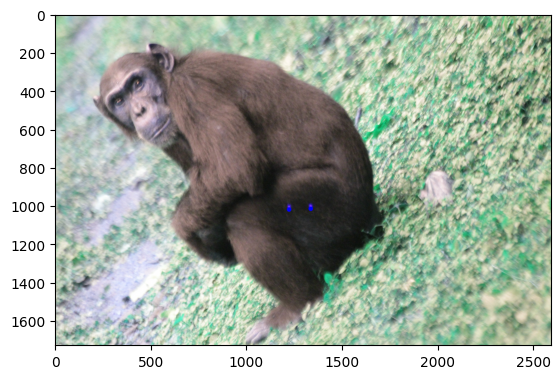

In [ ]:
best_mask = segmentation_mask
output = np.zeros_like(segment_im)
output[best_mask] = segment_im[best_mask]
plt.imshow(img)
plt.show()

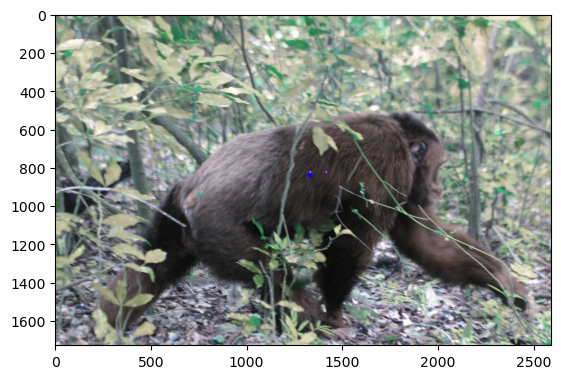

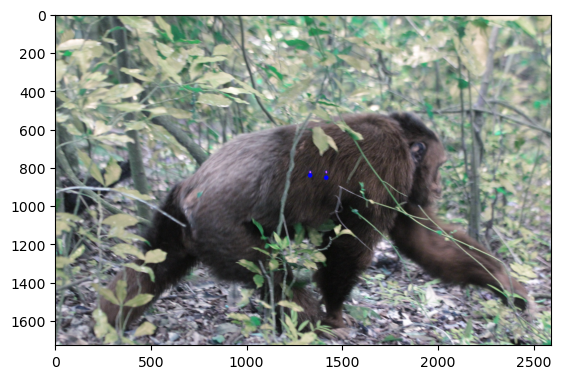

In [4]:

from skimage.feature import blob_log

img = cv2.imread('red_laser.jpg')
#img2 = output

# Assuming 'img' is your input image
hsv_frame = cv2.cvtColor(img, cv2.COLOR_BGR2HSV) #convert from BGR to HSV

# Define two ranges for red (due to the circular nature of the hue scale in HSV)
low_red1 = np.array([0, 120, 70])
high_red1 = np.array([10, 255, 255])
low_red2 = np.array([170, 120, 70])
high_red2 = np.array([180, 255, 255])

# Create masks for the red ranges
red_mask1 = cv2.inRange(hsv_frame, low_red1, high_red1)
red_mask2 = cv2.inRange(hsv_frame, low_red2, high_red2)
red_mask = cv2.bitwise_or(red_mask1, red_mask2)

# Apply mask to the image
red = cv2.bitwise_and(img, img, mask=red_mask)

# Extract red channel for processing (assuming red dots are the brightest in the red channel)
r = red[:,:,2]

# Apply Gaussian blur for smoothing
blur = cv2.GaussianBlur(r, (25, 25), 0)

# Apply thresholding
ret3, thresh = cv2.threshold(blur, 210, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Dilation to enlarge dots (tune parameters as needed)
thresh = cv2.dilate(thresh, (5, 5), iterations=28)

# Blob detection
blobs = blob_log(thresh, max_sigma=50, threshold=0.15)
count =0
points = []
if blobs.size != 0:  #checks if a blob was found
# ax[1].imshow(thresh, cmap='gray')
    for blob in blobs[:2,:]:
        y, x, area = blob
        if area>1:   #checks for area of blob
            count +=1
            points.append((int(x),int(y)))
            result1 = cv2.circle(img, (int(x),int(y)),12,(0,0,255),-1) # draws circles on detected blob
            plt.imshow(result1)
            plt.show()

In [5]:
points

[(1333, 842), (1417, 854)]

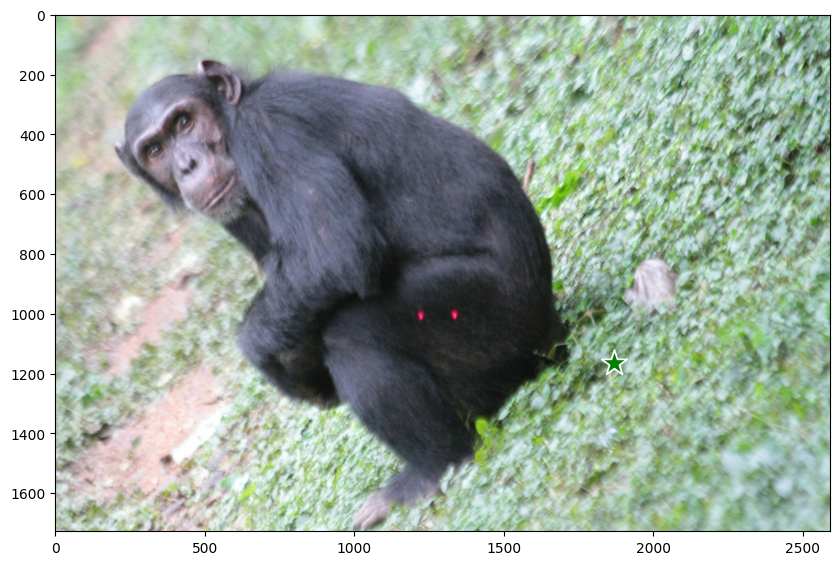

In [ ]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

im = cv2.imread('561.JPG')
segment_im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)

input_point = np.array([[1870, 1165]]) # SET THIS POINT

input_label = np.array([1])
plt.figure(figsize=(10,10))
plt.imshow(segment_im)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()